# Imports

In [38]:
import torch
import torchvision
import torchvision.transforms as transforms
from torch.utils.data import DataLoader, Dataset, random_split
import pandas as pd
import os
from PIL import Image
import torch.nn as nn
import torch.optim as optim
import torch.nn.functional as F
import matplotlib.pyplot as plt
from torchvision.models import resnet152, ResNet152_Weights, efficientnet_v2_m, EfficientNet_V2_M_Weights
import numpy as np
from torch.autograd import Variable
import random

# Data Loaders

In [39]:
class CustomDataset(Dataset):
    def __init__(self, csv_file, img_dir, transform=None):
        self.img_labels = pd.read_csv(csv_file)
        self.img_dir =img_dir
        self.transform = transform

    def __len__(self):
        return len(self.img_labels)

    def __getitem__(self, index):
        img_path = os.path.join(self.img_dir, self.img_labels.iloc[index, 0])
        image = Image.open(img_path).convert("RGB")
        label = self.img_labels.iloc[index, 1]
        if self.transform:
            image = self.transform(image)

        return image, label


In [4]:
class CustomDataset_Test(Dataset):
    def __init__(self, csv_file, img_dir, transform=None):
        self.img_labels = pd.read_csv(csv_file)
        self.img_dir =img_dir
        self.transform = transform

    def __len__(self):
        return len(self.img_labels)

    def __getitem__(self, index):
        img_path = os.path.join(self.img_dir, self.img_labels.iloc[index, 0])
        image = Image.open(img_path).convert("RGB")
        # label = self.img_labels.iloc[index, 1]
        if self.transform:
            image = self.transform(image)

        return image


# Helper Functions

In [40]:

# Function to visualize random samples from the dataset
def visualize_samples(dataset, num_samples=8):
    fig, axes = plt.subplots(1, num_samples, figsize=(15, 3))
    for i in range(num_samples):
        idx = np.random.randint(len(dataset))
        sample, label = dataset[idx]
        axes[i].imshow(np.transpose(sample.numpy(), (1, 2, 0)))
        axes[i].set_title(f"Label: {label}")
        axes[i].axis('off')
    plt.show()

# Function to visualize one batch from the data loader
def visualize_batch(dataloader, num_images_per_row = 5):
    images,labels = next(iter(dataloader))
    


    num_rows = len(images) // num_images_per_row
    if len(images) % num_images_per_row != 0:
        num_rows += 1

    fig, axes = plt.subplots(num_rows, num_images_per_row, figsize=(15, 3 * num_rows))

    for i in range(num_rows):
        for j in range(num_images_per_row):
            index = i * num_images_per_row + j
            if index < len(images):
                axes[i, j].imshow(np.transpose(images[index].numpy(), (1, 2, 0)))
                axes[i, j].set_title(f"Label: {labels[index].item()}")
                axes[i, j].axis('off')
            else:
                axes[i, j].axis('off')

    plt.show()

class FocusedCrop(torch.nn.Module):
    def __init__(self, top_p, right_p):
        super(FocusedCrop, self).__init__()
        self.top_crop = top_p
        self.right_crop = right_p
        
    def forward(self,img):
        width, height = img.size
        left = width * (1 - self.right_crop) / 2
        top = height * (1 - self.top_crop) / 2
        right = width * (1 + self.right_crop) / 2
        bottom = height * (1 + self.top_crop) / 2
        return img.crop((left, top, right, bottom))

def process_image(path, transform):
    with Image.open(path) as img:
        fig, axs = plt.subplots(1, 2, figsize=(10, 5))

        axs[0].imshow(img)
        axs[0].set_title('Without Crop')

        #Ensures we are always cropping every image
        cropped_img = transform(img)

        axs[1].imshow(cropped_img)
        axs[1].set_title('With Crop')

        plt.tight_layout()
        plt.show()


# PreProcessing

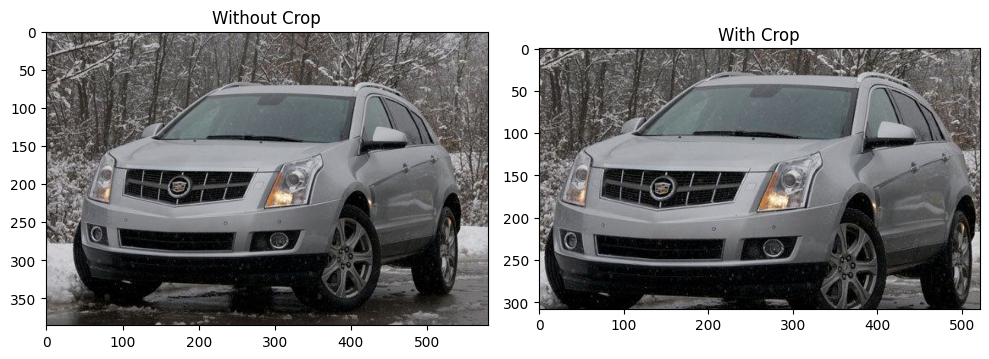

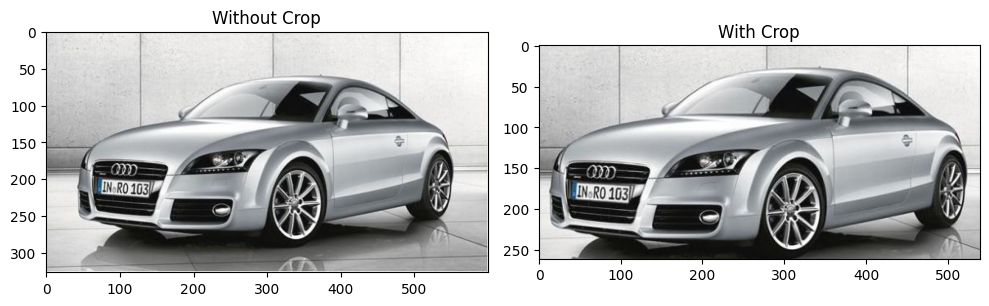

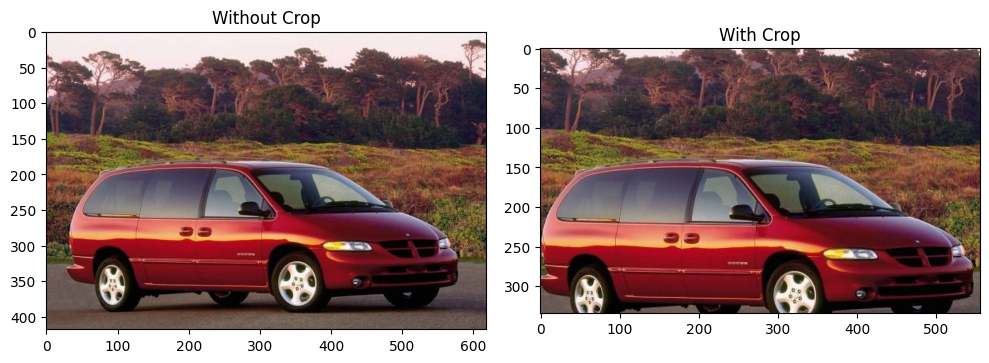

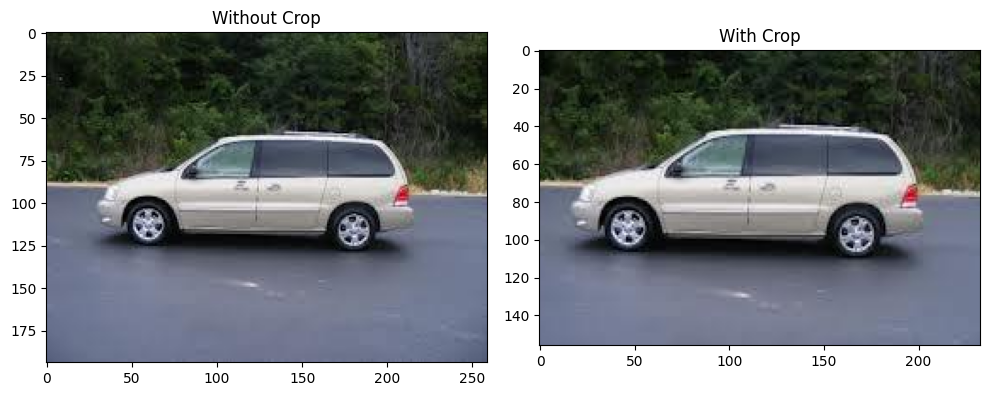

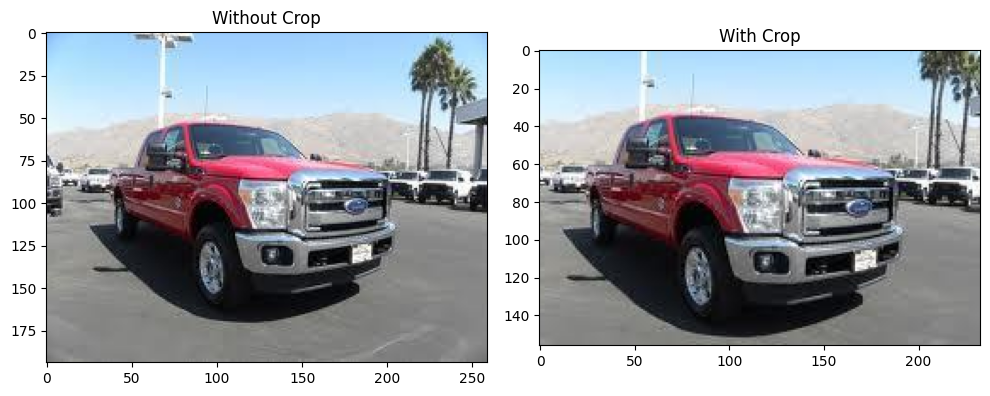

...

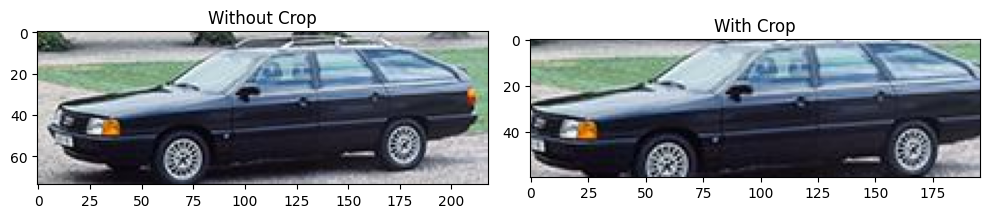

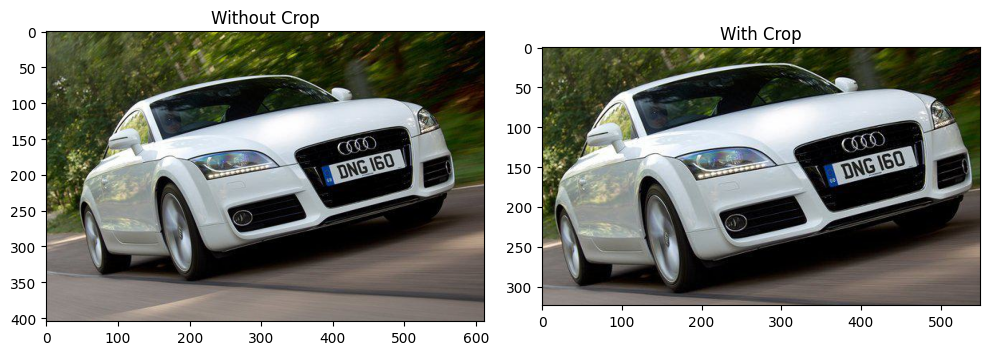

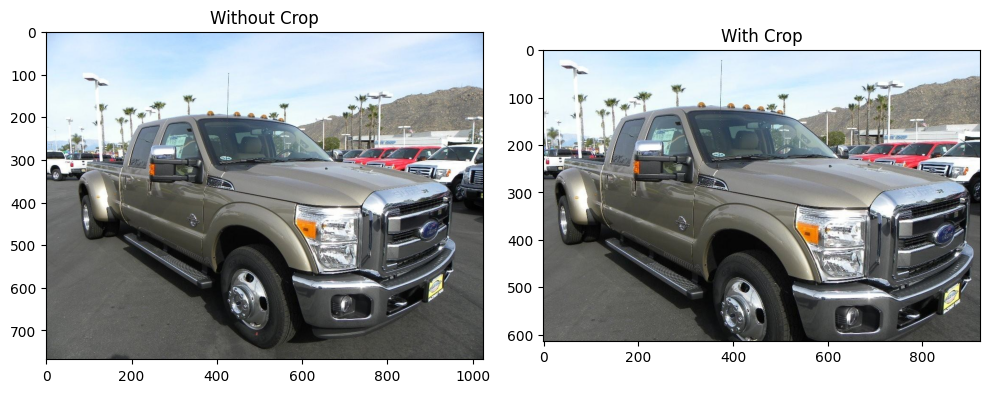

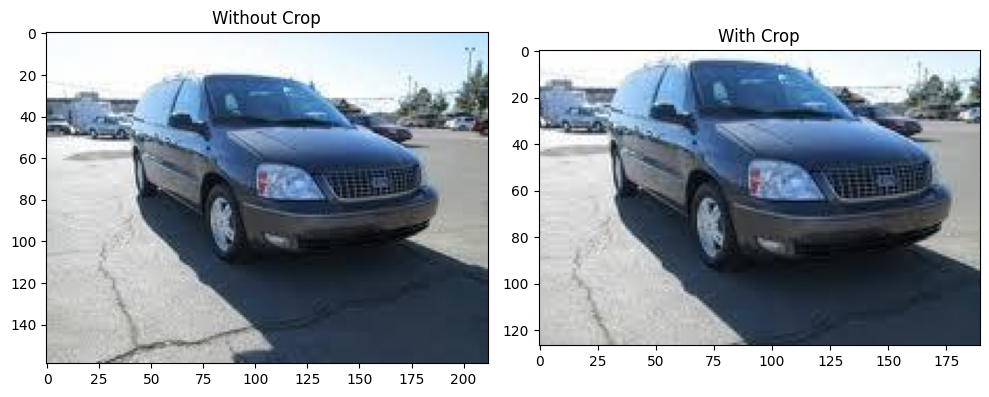

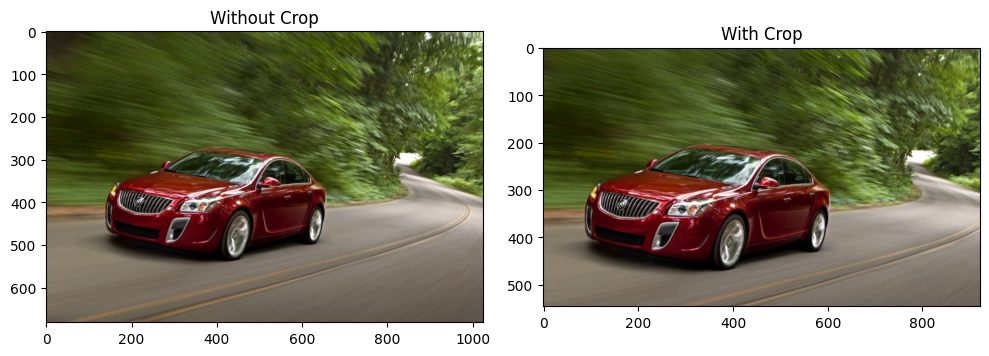

In [60]:
r_p = 0.9
t_p = 0.8

t = transforms.Compose([
    FocusedCrop(top_p=t_p, right_p=r_p),
])
folder_name = "/Users/alijohnnaqvi/Desktop/Fall23/DeepLearning/Assignments/Assignment3/599_DL_A3/data/train/"
for _ in range(50):
    num =  random.randint(1,4000)
    process_image(f"{folder_name}{num}.jpg", t)

# Data Augmentation

In [42]:

class RandomAffine(torch.nn.Module):
    def __init__(self,p):
        super(RandomAffine,self).__init__()
        self.prob = p

    def forward(self,image):
        if random.random() < self.prob:
            affine_transform = transforms.RandomAffine(degrees=(-5,5),scale=(0.9,0.95))
            transformed_image = affine_transform(image)
            return transformed_image
        else:
            return image


class RandomPad(torch.nn.Module):
    def __init__(self,p):
        super(RandomPad,self).__init__()
        self.prob = p

    def forward(self,image):
        if random.random() < self.prob:
            pad_transform = transforms.Pad(padding_mode='edge',padding=10)
            transformed_image = pad_transform(image)
            return transformed_image
        else:
            return image



class RandomBlur(torch.nn.Module):
    def __init__(self,p):
        super(RandomBlur,self).__init__()
        self.prob = p

    def forward(self,image):
        if random.random() < self.prob:
            blur_transform = transforms.GaussianBlur(kernel_size=(5,9),sigma=(0.1,1.5)) # more sigma more blur
            transformed_image = blur_transform(image)
            return transformed_image
        else:
            return image


class RandomSharp(torch.nn.Module):
    def __init__(self,p):
        super(RandomSharp,self).__init__()
        self.prob = p

    def forward(self,image):
        if random.random() < self.prob:
            sharp_transform = transforms.RandomAdjustSharpness(sharpness_factor=2) # more sigma more blur
            transformed_image = sharp_transform(image)
            return transformed_image
        else:
            return image


class RandomEqualize(torch.nn.Module):
    def __init__(self,p):
        super(RandomEqualize,self).__init__()
        self.prob = p

    def forward(self,image):
        if random.random() < self.prob:
            equalize_transform = transforms.RandomEqualize() # more sigma more blur
            transformed_image = equalize_transform(image)
            return transformed_image
        else:
            return image


transform = transforms.Compose([
    FocusedCrop(0.9,0.8),
    transforms.RandomHorizontalFlip(),
    transforms.RandomRotation(degrees=15),
    transforms.ColorJitter(brightness=0.2, contrast=0.2),
    transforms.RandomAutocontrast(0.1),
    #transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
    RandomSharp(0.1),
    RandomEqualize(0.1),
    RandomPad(0.1),
    transforms.Resize((256, 512)),
    transforms.ToTensor(),
])



# Creating Datasets

In [43]:
train_dataset = CustomDataset(csv_file='/Users/alijohnnaqvi/Desktop/Fall23/DeepLearning/Assignments/Assignment3/599_DL_A3/data/train.csv', img_dir='/Users/alijohnnaqvi/Desktop/Fall23/DeepLearning/Assignments/Assignment3/599_DL_A3/data', transform=transform)

In [44]:
train_size = int(0.8 * len(train_dataset))
val_size = int(0.2 * len(train_dataset))


train_subset, val_subset = random_split(train_dataset, [train_size, val_size])

train_loader = DataLoader(train_subset, batch_size=16, shuffle=True)
val_loader = DataLoader(val_subset, batch_size=16, shuffle=False)


print(len(train_subset))
print(len(val_subset))


3308
827


# Training Loop

In [46]:

def train_model(model, train_loader, val_loader, best_model_path, device = 'mps', num_epochs=30, learning_rate=0.0001):
    criterion = nn.CrossEntropyLoss()
    optimizer = optim.SGD(model.parameters(), lr=learning_rate, momentum=0.87)

    train_losses = []
    val_losses = []
    train_accs = []
    val_accs = []
    best_loss = torch.inf
    for epoch in range(num_epochs):
        model.train()
        running_loss = 0.0
        correct_train = 0
        total_train = 0

        for inputs, labels in train_loader:
            inputs = inputs.to(device)
            labels = labels.to(device)
            optimizer.zero_grad()
            outputs = model(inputs)
            loss = criterion(outputs, labels)
            loss.backward()
            optimizer.step()

            running_loss += loss.item()
            _, predicted = outputs.max(1)
            total_train += labels.size(0)
            correct_train += predicted.eq(labels).sum().item()

        train_loss = running_loss / len(train_loader)
        train_acc = 100. * correct_train / total_train
        train_losses.append(train_loss)
        train_accs.append(train_acc)

        model.eval()
        val_running_loss = 0.0
        correct_val = 0
        total_val = 0

        with torch.no_grad():
            for val_inputs, val_labels in val_loader:
                val_inputs = val_inputs.to(device)
                val_labels = val_labels.to(device)
                val_outputs = model(val_inputs)
                val_loss = criterion(val_outputs, val_labels)
                val_running_loss += val_loss.item()

                _, val_predicted = val_outputs.max(1)
                total_val += val_labels.size(0)
                correct_val += val_predicted.eq(val_labels).sum().item()

        val_loss = val_running_loss / len(val_loader)
        val_acc = 100. * correct_val / total_val
        val_losses.append(val_loss)
        val_accs.append(val_acc)

        if val_loss < best_loss:
            model_name = f'{best_model_path}resnet50_{val_acc}' 
            torch.save(model, model_name )
            print(f'saved model with accuracy: {val_acc} %')
            best_loss = val_loss

        print(f'Epoch [{epoch+1}/{num_epochs}] Train Loss: {train_loss:.4f} Train Acc: {train_acc:.2f}% '
              f'Val Loss: {val_loss:.4f} Val Acc: {val_acc:.2f}%')

    return train_losses, val_losses, train_accs, val_accs


# Model Defining - Transfer Learning

### 1st iteration

In [18]:
weights = ResNet152_Weights.IMAGENET1K_V2
model_resnet = resnet152(weights=weights)
model_resnet.fc = nn.Linear(2048, 100)
model_resnet

ResNet(
  (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace=True)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): Bottleneck(
      (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (downsample): Sequential(
        (0): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 

In [9]:
device = torch.device('mps')
model = model_resnet.to(device)

In [12]:
train_losses, val_losses, train_accs, val_accs = train_model(model, train_loader, val_loader, device = device, num_epochs=50, best_model_path='/Users/alijohnnaqvi/Desktop/Fall23/DeepLearning/Assignments/Assignment3/599_DL_A3/Models/')

saved model with accuracy: 48.12575574365175 %
Epoch [1/50] Train Loss: 2.8916 Train Acc: 38.21% Val Loss: 2.5630 Val Acc: 48.13%
saved model with accuracy: 49.8186215235792 %
Epoch [2/50] Train Loss: 2.6002 Train Acc: 43.05% Val Loss: 2.3338 Val Acc: 49.82%
saved model with accuracy: 54.41354292623942 %
Epoch [3/50] Train Loss: 2.3330 Train Acc: 50.48% Val Loss: 2.0746 Val Acc: 54.41%
saved model with accuracy: 57.194679564691654 %
Epoch [4/50] Train Loss: 2.1080 Train Acc: 54.53% Val Loss: 1.8998 Val Acc: 57.19%
saved model with accuracy: 59.73397823458283 %
Epoch [5/50] Train Loss: 1.8878 Train Acc: 58.77% Val Loss: 1.7173 Val Acc: 59.73%
saved model with accuracy: 62.152357920193474 %
Epoch [6/50] Train Loss: 1.6695 Train Acc: 63.51% Val Loss: 1.5823 Val Acc: 62.15%
saved model with accuracy: 64.57073760580411 %
Epoch [7/50] Train Loss: 1.4945 Train Acc: 67.71% Val Loss: 1.4443 Val Acc: 64.57%
saved model with accuracy: 67.47279322853689 %
Epoch [8/50] Train Loss: 1.3559 Train Acc:

### Iteration# 2 - Resnet152

In [ ]:
weights = ResNet152_Weights.IMAGENET1K_V2
model_resnet = resnet152(weights=weights)
model_resnet.fc = nn.Linear(2048, 100)
device = torch.device('mps')
model = model_resnet.to(device)

In [23]:
train_losses, val_losses, train_accs, val_accs = train_model(model, train_loader, val_loader, device = device, num_epochs=20, best_model_path='/Users/alijohnnaqvi/Desktop/Fall23/DeepLearning/Assignments/Assignment3/599_DL_A3/Models/Resnet150/')

saved model with accuracy: 1.5719467956469166 %
Epoch [1/20] Train Loss: 4.6015 Train Acc: 0.94% Val Loss: 4.5776 Val Acc: 1.57%
saved model with accuracy: 3.3857315598548974 %
Epoch [2/20] Train Loss: 4.5576 Train Acc: 2.81% Val Loss: 4.5451 Val Acc: 3.39%
saved model with accuracy: 4.594921402660217 %
Epoch [3/20] Train Loss: 4.5006 Train Acc: 5.44% Val Loss: 4.4849 Val Acc: 4.59%
saved model with accuracy: 5.804111245465538 %
Epoch [4/20] Train Loss: 4.4152 Train Acc: 8.16% Val Loss: 4.3989 Val Acc: 5.80%
saved model with accuracy: 10.399032648125756 %
Epoch [5/20] Train Loss: 4.2755 Train Acc: 10.91% Val Loss: 4.2248 Val Acc: 10.40%
saved model with accuracy: 13.05925030229746 %
Epoch [6/20] Train Loss: 4.0507 Train Acc: 14.90% Val Loss: 3.9762 Val Acc: 13.06%
saved model with accuracy: 19.951632406287786 %
Epoch [7/20] Train Loss: 3.7785 Train Acc: 19.80% Val Loss: 3.6770 Val Acc: 19.95%
saved model with accuracy: 23.57920193470375 %
Epoch [8/20] Train Loss: 3.4622 Train Acc: 25.7

### Iteration# 3 -- Resume Training

In [12]:
model = torch.load('/Users/alijohnnaqvi/Desktop/Fall23/DeepLearning/Assignments/Assignment3/599_DL_A3/Models/resnet_ValA=90')
train_losses, val_losses, train_accs, val_accs = train_model(model, train_loader, val_loader, device = device, num_epochs=20, best_model_path='/Users/alijohnnaqvi/Desktop/Fall23/DeepLearning/Assignments/Assignment3/599_DL_A3/Models/')

saved model with accuracy: 94.92140266021765 %
Epoch [1/20] Train Loss: 0.2957 Train Acc: 92.96% Val Loss: 0.2038 Val Acc: 94.92%
Epoch [2/20] Train Loss: 0.2429 Train Acc: 94.59% Val Loss: 0.2096 Val Acc: 94.56%
Epoch [3/20] Train Loss: 0.2045 Train Acc: 95.95% Val Loss: 0.2163 Val Acc: 94.68%
saved model with accuracy: 95.16324062877872 %
Epoch [4/20] Train Loss: 0.1838 Train Acc: 96.22% Val Loss: 0.1883 Val Acc: 95.16%
Epoch [5/20] Train Loss: 0.1581 Train Acc: 97.16% Val Loss: 0.1899 Val Acc: 94.56%
Epoch [6/20] Train Loss: 0.1501 Train Acc: 97.10% Val Loss: 0.2147 Val Acc: 93.83%
saved model with accuracy: 95.16324062877872 %
Epoch [7/20] Train Loss: 0.1211 Train Acc: 97.97% Val Loss: 0.1867 Val Acc: 95.16%
Epoch [8/20] Train Loss: 0.1100 Train Acc: 98.00% Val Loss: 0.2118 Val Acc: 93.95%
Epoch [9/20] Train Loss: 0.0999 Train Acc: 98.58% Val Loss: 0.2088 Val Acc: 93.71%
saved model with accuracy: 94.80048367593712 %
Epoch [10/20] Train Loss: 0.0904 Train Acc: 98.70% Val Loss: 0.18

### Iteration #4 --Training same model with different hyperparameters

In [35]:
device = torch.device('mps')
model  = torch.load('/Users/alijohnnaqvi/Desktop/Fall23/DeepLearning/Assignments/Assignment3/599_DL_A3/Models/resnet_94')
model = model.to(device)

In [37]:
train_losses, val_losses, train_accs, val_accs = train_model(model, train_loader, val_loader, device = device, num_epochs=12, best_model_path='/Users/alijohnnaqvi/Desktop/Fall23/DeepLearning/Assignments/Assignment3/599_DL_A3/Models/',learning_rate = 0.1)

saved model with accuracy: 47.76299879081016 %
Epoch [1/12] Train Loss: 2.0903 Train Acc: 43.32% Val Loss: 1.8946 Val Acc: 47.76%
saved model with accuracy: 53.32527206771463 %
Epoch [2/12] Train Loss: 1.2602 Train Acc: 61.76% Val Loss: 1.5766 Val Acc: 53.33%
saved model with accuracy: 65.77992744860943 %
Epoch [3/12] Train Loss: 0.8571 Train Acc: 73.34% Val Loss: 1.2219 Val Acc: 65.78%
Epoch [4/12] Train Loss: 0.7024 Train Acc: 78.51% Val Loss: 1.2568 Val Acc: 64.09%
saved model with accuracy: 66.86819830713422 %
Epoch [5/12] Train Loss: 0.5449 Train Acc: 83.62% Val Loss: 1.1453 Val Acc: 66.87%
saved model with accuracy: 67.956469165659 %
Epoch [6/12] Train Loss: 0.4360 Train Acc: 86.37% Val Loss: 1.1335 Val Acc: 67.96%
Epoch [7/12] Train Loss: 0.3505 Train Acc: 88.51% Val Loss: 1.3676 Val Acc: 62.27%
saved model with accuracy: 70.13301088270859 %
Epoch [8/12] Train Loss: 0.3549 Train Acc: 88.97% Val Loss: 1.1117 Val Acc: 70.13%
Epoch [9/12] Train Loss: 0.3055 Train Acc: 90.72% Val Lo

### Iteration# 5 Training with smaller lr

In [47]:
device = torch.device('mps')
model  = torch.load('/Users/alijohnnaqvi/Desktop/Fall23/DeepLearning/Assignments/Assignment3/599_DL_A3/Models/resnet_94_2')
model = model.to(device)

In [48]:
train_losses, val_losses, train_accs, val_accs = train_model(model, train_loader, val_loader, device = device, num_epochs=12, best_model_path='/Users/alijohnnaqvi/Desktop/Fall23/DeepLearning/Assignments/Assignment3/599_DL_A3/Models/',learning_rate = 0.0001)

saved model with accuracy: 97.70253929866989 %
Epoch [1/12] Train Loss: 0.1406 Train Acc: 97.07% Val Loss: 0.0910 Val Acc: 97.70%
saved model with accuracy: 98.42805320435308 %
Epoch [2/12] Train Loss: 0.1408 Train Acc: 97.01% Val Loss: 0.0790 Val Acc: 98.43%
Epoch [3/12] Train Loss: 0.1336 Train Acc: 97.52% Val Loss: 0.0911 Val Acc: 97.82%
Epoch [4/12] Train Loss: 0.1281 Train Acc: 97.13% Val Loss: 0.0891 Val Acc: 97.94%
Epoch [5/12] Train Loss: 0.1216 Train Acc: 97.64% Val Loss: 0.0886 Val Acc: 97.70%
Epoch [6/12] Train Loss: 0.1184 Train Acc: 97.85% Val Loss: 0.0958 Val Acc: 97.22%
Epoch [7/12] Train Loss: 0.1113 Train Acc: 97.94% Val Loss: 0.0937 Val Acc: 97.34%
saved model with accuracy: 97.82345828295043 %
Epoch [8/12] Train Loss: 0.1119 Train Acc: 98.13% Val Loss: 0.0766 Val Acc: 97.82%
Epoch [9/12] Train Loss: 0.1105 Train Acc: 98.10% Val Loss: 0.0820 Val Acc: 98.07%
Epoch [10/12] Train Loss: 0.1136 Train Acc: 97.85% Val Loss: 0.0780 Val Acc: 98.07%
Epoch [11/12] Train Loss: 0.

### loss curves

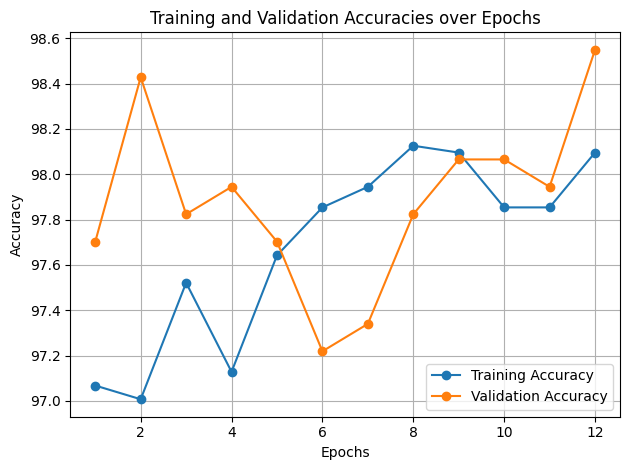

In [61]:
epochs_list = [1,2,3,4,5,6,7,8,9,10,11,12]
plt.plot(epochs_list, train_accs, marker='o', label='Training Accuracy')
plt.plot(epochs_list, val_accs, marker='o', label='Validation Accuracy')

plt.title('Training and Validation Accuracies over Epochs')
plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.legend()
plt.grid(True)

plt.tight_layout()
plt.show()


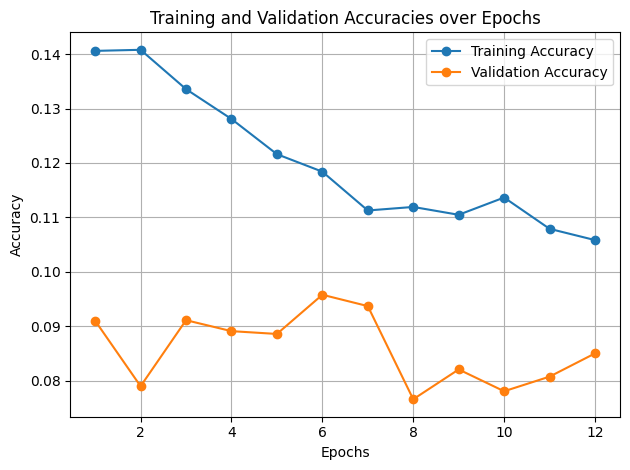

In [62]:
plt.plot(epochs_list, train_losses, marker='o', label='Training Accuracy')
plt.plot(epochs_list, val_losses, marker='o', label='Validation Accuracy')

plt.title('Training and Validation Accuracies over Epochs')
plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.legend()
plt.grid(True)

plt.tight_layout()
plt.show()

# Generating test labels

In [55]:
model = torch.load('/Users/alijohnnaqvi/Desktop/Fall23/DeepLearning/Assignments/Assignment3/599_DL_A3/Models/resnet_ValA=97_2')

In [56]:
test_csv_path = '/Users/alijohnnaqvi/Desktop/Fall23/DeepLearning/Assignments/Assignment3/599_DL_A3/data/test.csv'
test_data = pd.read_csv(test_csv_path)
print(test_data['id'])


0       test/4136.jpg
1       test/4137.jpg
2       test/4138.jpg
3       test/4139.jpg
4       test/4140.jpg
            ...      
4075    test/8211.jpg
4076    test/8212.jpg
4077    test/8213.jpg
4078    test/8214.jpg
4079    test/8215.jpg
Name: id, Length: 4080, dtype: object


In [57]:
predictions = []
model =  model.to('mps')
model.eval()
for idx, row in test_data.iterrows():
    image_path = '/Users/alijohnnaqvi/Desktop/Fall23/DeepLearning/Assignments/Assignment3/599_DL_A3/data/' + row.item() # Adjust accordingly
    image = Image.open(image_path).convert("RGB")
    image = transform(image)
    image = image.to('mps')
    
    image = Variable(image.unsqueeze(0))  # Add batch dimension
    output = model(image)
    _, predicted_label = torch.max(output.data, 1)
    print(predicted_label)
    predictions.append(predicted_label.item())

tensor([92], device='mps:0')
tensor([67], device='mps:0')
tensor([21], device='mps:0')
tensor([49], device='mps:0')
tensor([38], device='mps:0')
tensor([97], device='mps:0')
tensor([72], device='mps:0')
tensor([40], device='mps:0')
tensor([22], device='mps:0')
tensor([11], device='mps:0')
tensor([21], device='mps:0')
tensor([70], device='mps:0')
tensor([69], device='mps:0')
tensor([80], device='mps:0')
tensor([32], device='mps:0')
tensor([22], device='mps:0')
tensor([20], device='mps:0')
tensor([58], device='mps:0')
tensor([19], device='mps:0')
tensor([95], device='mps:0')
tensor([54], device='mps:0')
tensor([24], device='mps:0')
tensor([64], device='mps:0')
tensor([74], device='mps:0')
tensor([14], device='mps:0')
tensor([64], device='mps:0')
tensor([25], device='mps:0')
tensor([24], device='mps:0')
tensor([26], device='mps:0')
tensor([60], device='mps:0')
tensor([72], device='mps:0')
tensor([32], device='mps:0')
tensor([5], device='mps:0')
tensor([65], device='mps:0')
tensor([40], de

In [58]:
new_column = np.array(predictions)
test_data['Predicted'] = predictions

In [12]:
test_data

,id,Predicted
0,test/4136.jpg,92
1,test/4137.jpg,67
2,test/4138.jpg,21
3,test/4139.jpg,49
4,test/4140.jpg,38
...,...,...
4075,test/8211.jpg,52
4076,test/8212.jpg,5
4077,test/8213.jpg,6
4078,test/8214.jpg,27


In [59]:
# save file
test_data.to_csv('results_resnet50_97_2.csv', index=False)
